In [1]:
library(tidyverse, verbose = FALSE)
library(lubridate, verbose = FALSE)
library(forecast, verbose = FALSE)
library(car, verbose = FALSE)
library(boot, verbose = FALSE)
library(zoo, verbose = FALSE)
library(ggplot2, verbose = FALSE)
library(factoextra, verbose = FALSE)
cities <- c(
  "New York", "Los Angeles", "Chicago", "Houston", "Phoenix",
  "Philadelphia", "San Antonio", "San Diego", "Dallas", "San Jose"
)
set.seed(5100)
pm25_raw <- read_csv("../../data/daily_88101_2023.csv", show_col_types = FALSE)
o3_raw   <- read_csv("../../data/daily_44201_2023.csv", show_col_types = FALSE)
no2_raw  <- read_csv("../../data/daily_42602_2023.csv", show_col_types = FALSE)

clean_pollutant <- function(df, pollutant_name) {
  df %>%
    filter(`City Name` %in% cities) %>%          # filter ROWS by city name
    mutate(Date = ymd(`Date Local`)) %>%         # convert date
    select(`City Name`, Date, `Arithmetic Mean`) %>%  # select correct columns
    rename(
      City = `City Name`,
      !!pollutant_name := `Arithmetic Mean`
    )
} 

pm25 <- clean_pollutant(pm25_raw, "PM25")
o3   <- clean_pollutant(o3_raw,   "O3")
# Convert o3 from ppm to ppb
o3 <- o3 %>%
  mutate(O3 = O3 * 1000)
no2  <- clean_pollutant(no2_raw,  "NO2")

air_df <- pm25 %>%
  inner_join(o3, by = c("City", "Date")) %>%
  inner_join(no2, by = c("City", "Date"))

# There are duplicate rows as the indicators have multiple monitoring sites per city. 
air_df_clean <- air_df %>%
  group_by(City, Date) %>%
  summarise(
    PM25 = mean(PM25, na.rm = TRUE),
    O3   = mean(O3,   na.rm = TRUE),
    NO2  = mean(NO2,  na.rm = TRUE),
    .groups = "drop"
  ) %>%
  arrange(City, Date)

# load weather data for all cities
city_weather_dfs <- list()
for (city in cities) {
    df <- read_csv(paste0("../../data/weather_data/", city, ".csv"), show_col_types = FALSE)

    # mutate date to not have time component
    df <- df %>%
      mutate(date = as.Date(date))

    city_weather_dfs[[city]] <- df
}

merge_weather_air <- function(city) {
  df <- city_weather_dfs[[city]]
  df <- df %>%
    inner_join(air_df_clean %>% filter(City == city), by = c("date" = "Date")) %>%
    select(date, temperature_2m_mean, cloud_cover_mean, relative_humidity_2m_mean, wind_gusts_10m_mean, wind_speed_10m_mean, precipitation_hours, precipitation_sum, PM25, O3, NO2)
  return(df)
}


dfs <- lapply(cities, merge_weather_air)
names(dfs) <- cities
big_df <- bind_rows(dfs, .id = "City")

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 4.0.0     ✔ purrr   1.1.0
✔ tibble  3.3.0     ✔ dplyr   1.1.4
✔ tidyr   1.3.1     ✔ stringr 1.5.2
✔ readr   2.1.5     ✔ forcats 0.5.1

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ purrr::%||%()   masks base::%||%()
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


Attaching package: ‘lubridate’


The following objects are masked from ‘package:base’:

    date, intersect, setdiff, union


Registered S3 method overwritten by 'quantmod':
  method            from
  as.zoo.data.frame zoo 

Loading required package: carData


Attaching package: ‘car’


The following object is masked from ‘package:dplyr’:

    recode


The following object is masked from ‘package:purrr’:

    some



Attaching package: ‘boot’


The following object is masked from ‘package:car’:

    logit



Attaching package: ‘zoo’


The following objects are masked fr

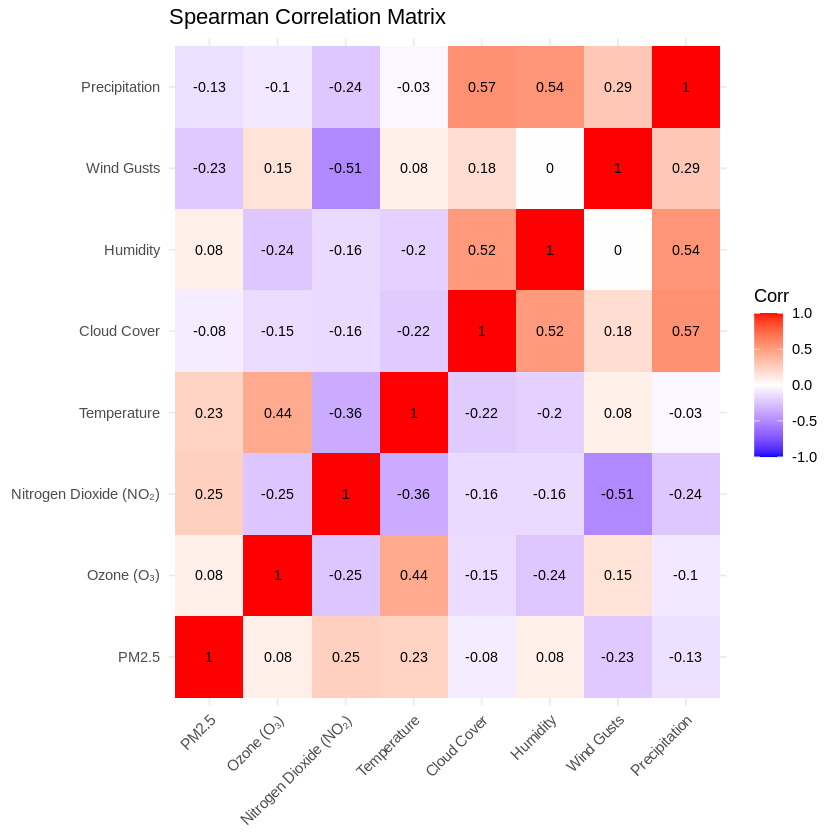

In [3]:
# Correlation matrix between all features and pollutants
vars <- c(
  "PM25", "O3", "NO2",
  "temperature_2m_mean",
  "cloud_cover_mean",
  "relative_humidity_2m_mean",
  "wind_gusts_10m_mean",
  "precipitation_sum"
)
custom_names <- c(
  PM25 = "PM2.5",
  O3 = "Ozone (O₃)",
  NO2 = "Nitrogen Dioxide (NO₂)",
  temperature_2m_mean = "Temperature",
  cloud_cover_mean = "Cloud Cover",
  relative_humidity_2m_mean = "Humidity",
  wind_gusts_10m_mean = "Wind Gusts",
  precipitation_sum = "Precipitation"
)


df_corr <- big_df[vars]
cor_matrix <- cor(df_corr, use = "complete.obs", method = "spearman")
rownames(cor_matrix) <- custom_names[rownames(cor_matrix)]
colnames(cor_matrix) <- custom_names[colnames(cor_matrix)]

df_long <- as.data.frame(as.table(cor_matrix))
colnames(df_long) <- c("Var1", "Var2", "Corr")
ggplot(df_long, aes(Var1, Var2, fill = Corr)) +
  geom_tile() +
  geom_text(aes(label = round(Corr, 2)), color = "black", size = 3) +
  scale_fill_gradient2(
    low = "blue",
    mid = "white",
    high = "red",
    midpoint = 0,
    limit = c(-1, 1)
  ) +
  theme_minimal() +
  theme(
    axis.text.x = element_text(angle = 45, hjust = 1),
    axis.title = element_blank()
  ) +
  labs(title = "Spearman Correlation Matrix")

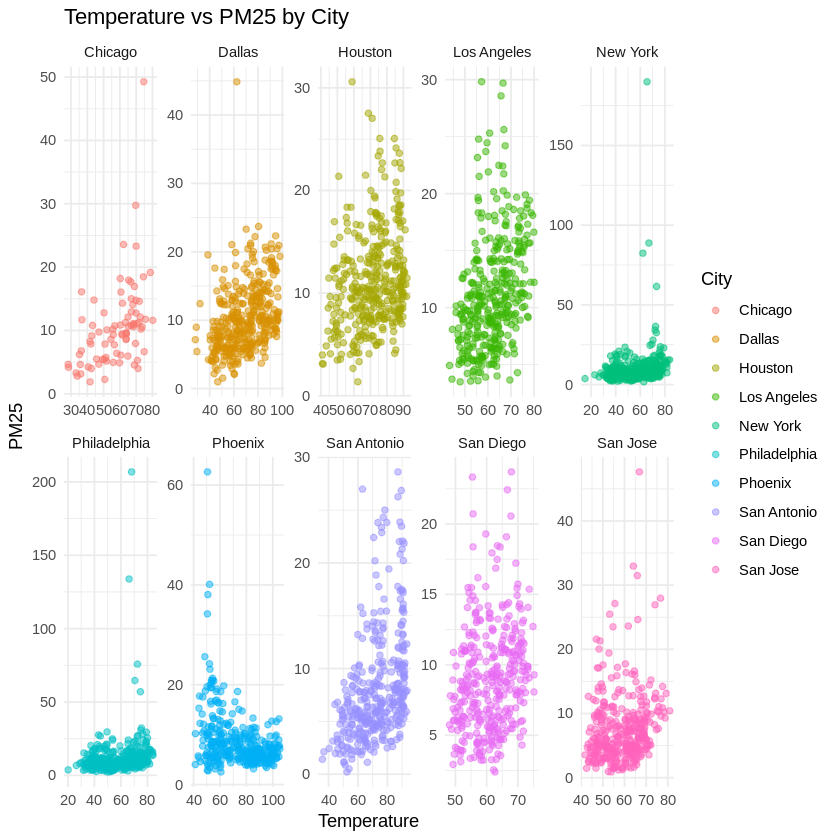

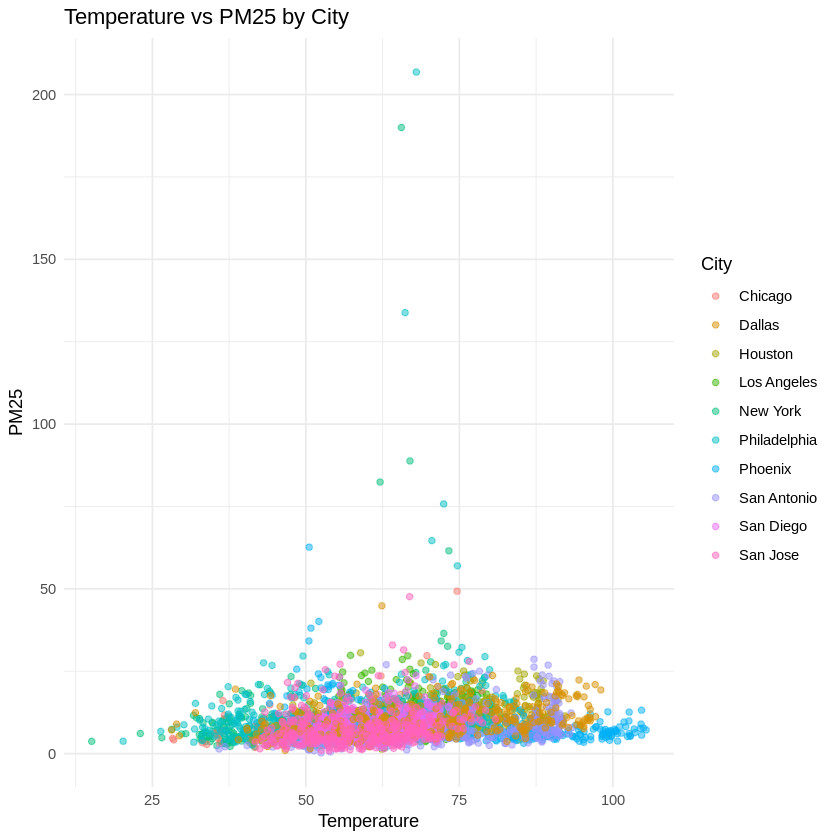

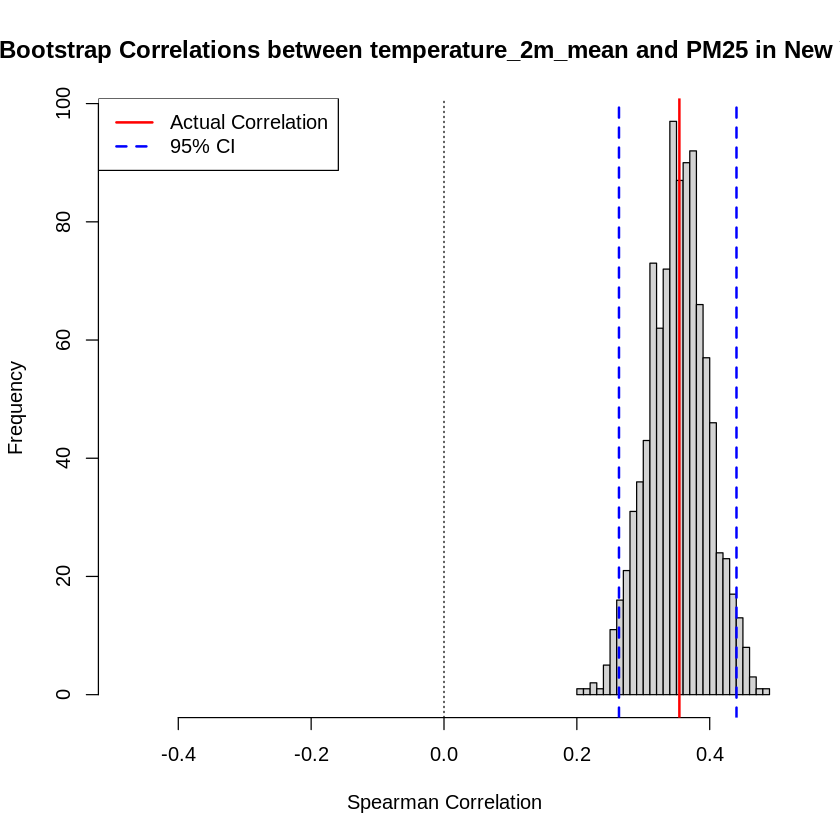

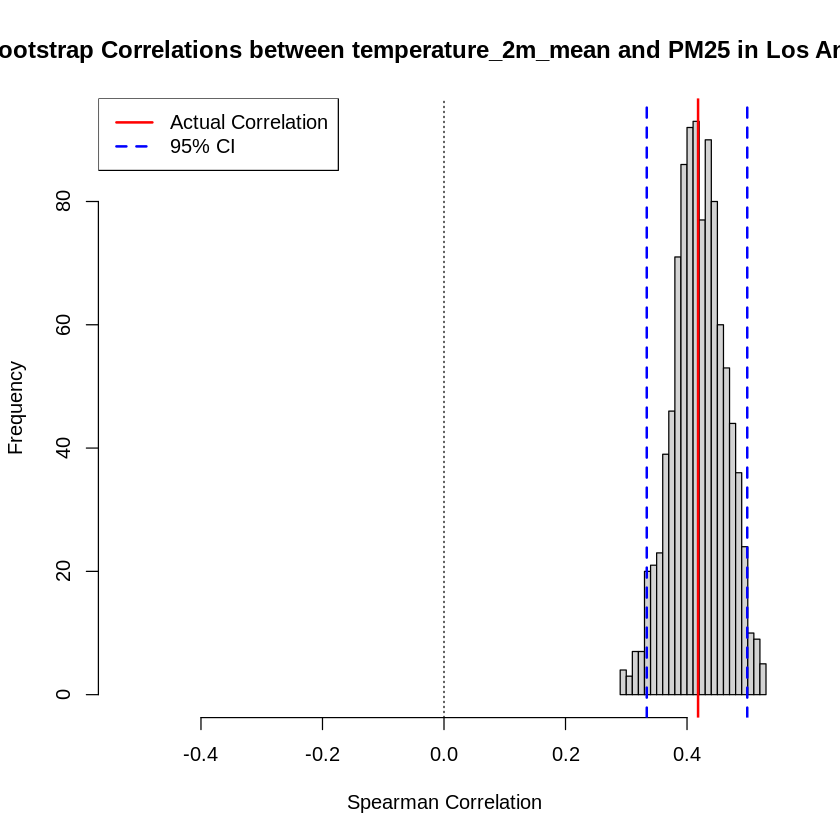

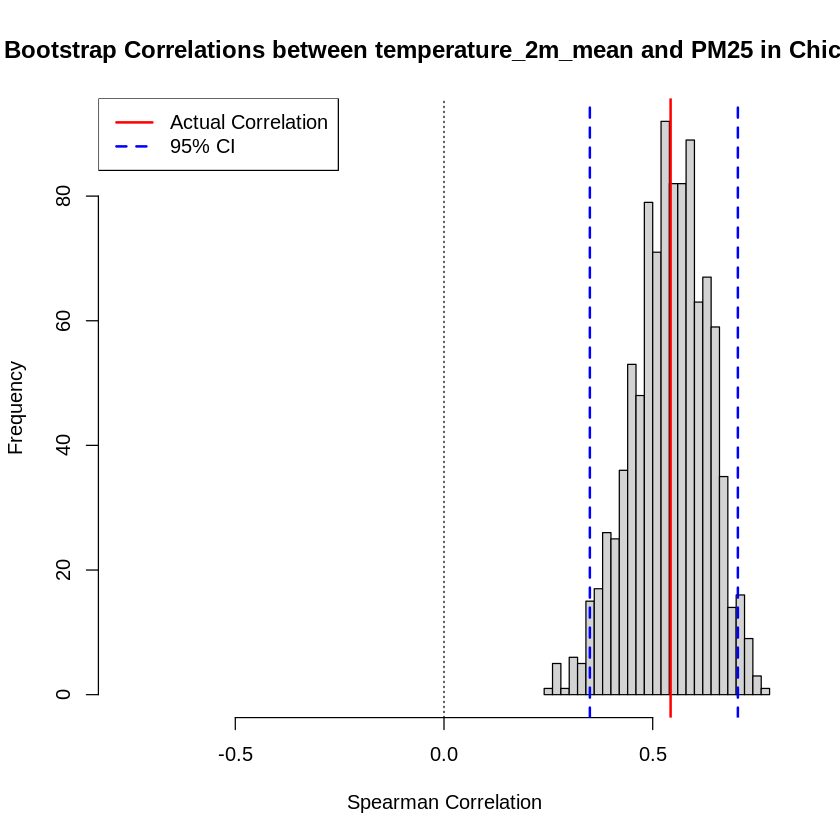

...

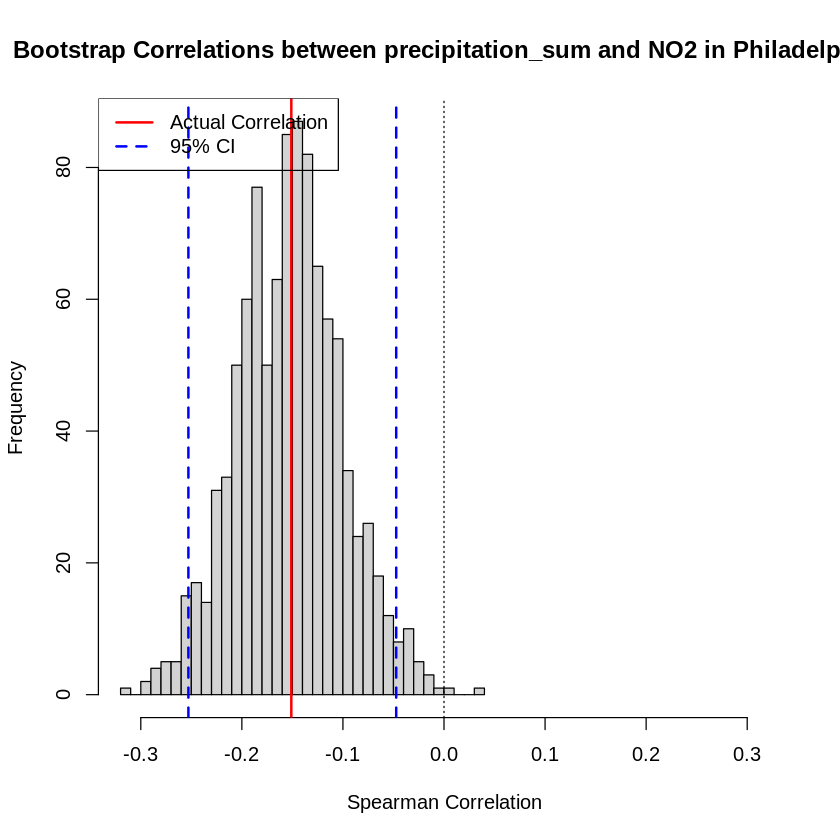

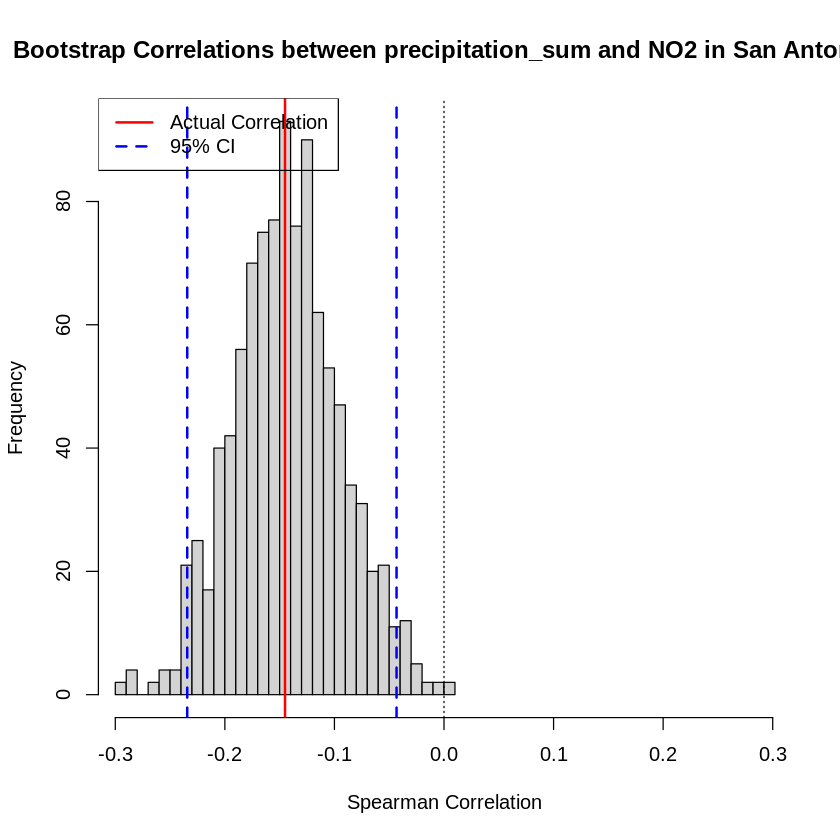

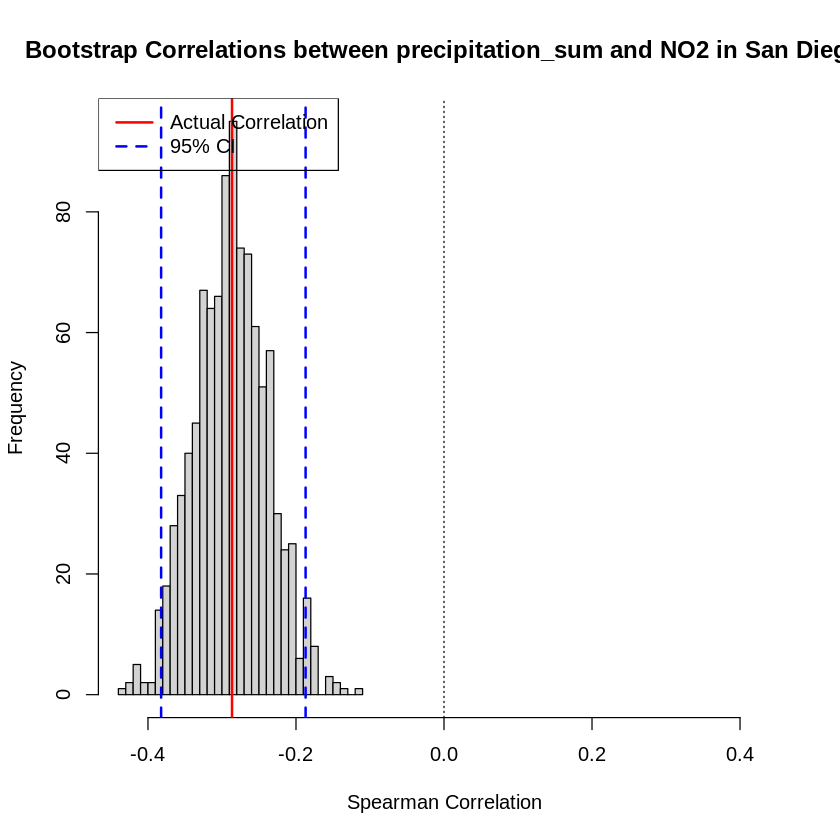

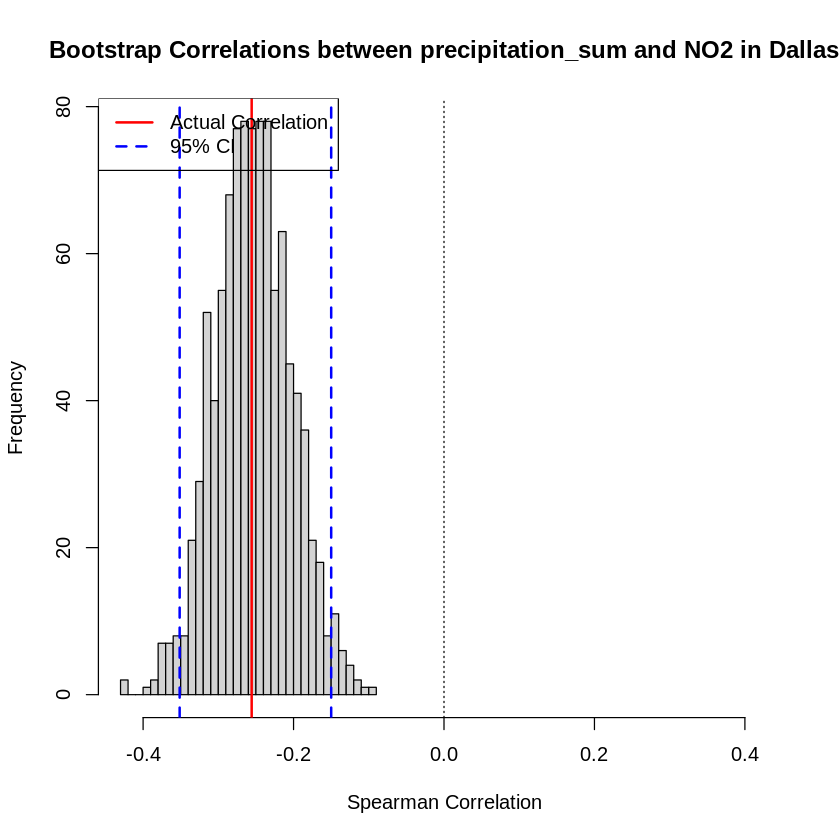

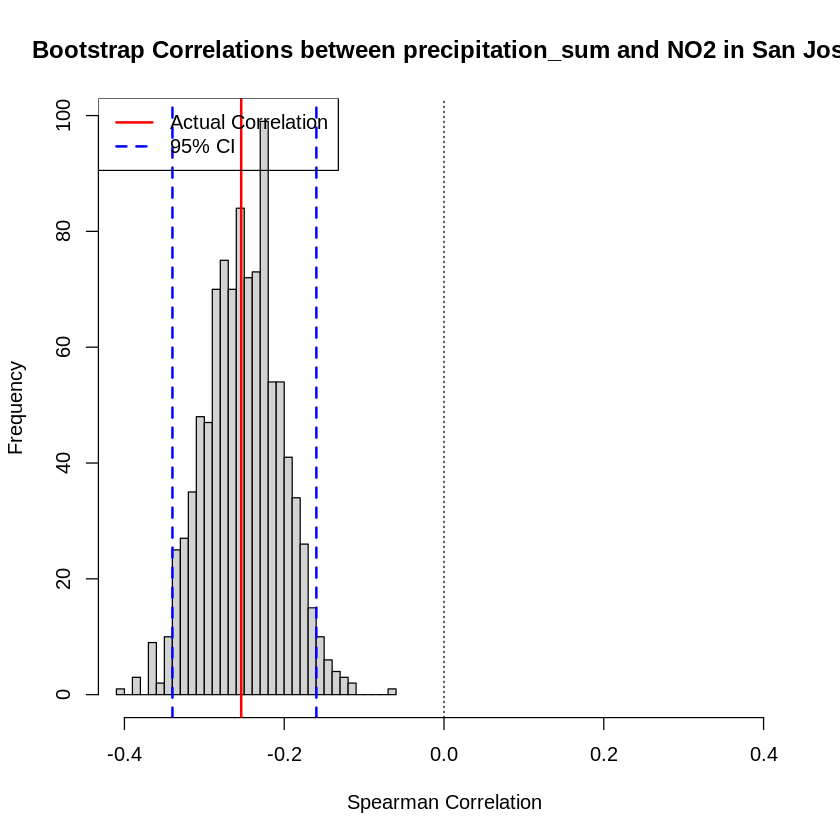

In [73]:
bootstrap <- function(df, city, feature, pollutant, b){
  bootstrap_correlations <- numeric(b)
  for (i in 1:b){
    sample <- df[sample(nrow(df), replace = TRUE), ]
    bootstrap_correlations[i] <- cor(sample[[feature]], sample[[pollutant]], method = "spearman")
  }

  # actual correlation between pollutant and temperature
  actual_correlation <- cor(df[[feature]], df[[pollutant]], method = "spearman")

  # 95% confidence interval
  ci <- quantile(bootstrap_correlations, c(0.025, 0.975))

  round(actual_correlation, 3)
  round(ci, 3)
  
  # plot histogram of bootstrap correlations and mark actual correlation and confidence intervals
  # png(paste0("../../plots/", city, "_bootstrap_", feature, "_", pollutant, ".png"))
  m <- max(abs(c(bootstrap_correlations, actual_correlation, ci)))
  hist(bootstrap_correlations, main = paste("Bootstrap Correlations between", feature, "and", pollutant, "in", city), xlab = "Spearman Correlation", breaks = 30, xlim = c(-m, m))
  abline(v = actual_correlation, col = "red", lwd = 2)
  abline(v = ci[1], col = "blue", lwd = 2, lty = 2)
  abline(v = ci[2], col = "blue", lwd = 2, lty = 2)
  abline(v = 0, col = "black", lwd = 1, lty = 3)
  legend("topleft", legend = c("Actual Correlation", "95% CI"), col = c("red", "blue"), lwd = 2, lty = c(1,2))
  # dev.off()
}

# empty "../../plots/" directory if it exists
if (dir.exists("../../plots/")) {
  unlink("../../plots/", recursive = TRUE)
}
# create "../../plots/" directory
dir.create("../../plots/")
if (!dir.exists("../../plots/")) {
  dir.create("../../plots/")
}

pollutants <- c("PM25", "O3", "NO2")
features <- c("temperature_2m_mean", "cloud_cover_mean", "relative_humidity_2m_mean", "wind_gusts_10m_mean", "wind_speed_10m_mean", "precipitation_hours", "precipitation_sum")
feature_names <- c("Temperature", "Cloud Cover", "Relative Humidity", "Wind Gusts", "Wind Speed", "Precipitation Hours", "Precipitation Sum")
# features<- c("cloud_cover_mean")
# feature_names <- c("Cloud Cover")

for (pollutant in pollutants) {
    for (i in 1:length(features)) {
        feature <- features[i]
        feature_name <- feature_names[i]
        print(
          ggplot(big_df, aes(x = .data[[feature]], y = .data[[pollutant]], color = City)) +
          geom_point(alpha = 0.5) +
          facet_wrap(~ City, ncol = 5, scales = "free") +
          labs(
            title = paste(feature_name, "vs", pollutant, "by City"),
            x = paste(feature_name),
            y = paste(pollutant)  
          ) +
          theme_minimal()

        )
        print(
        ggplot(big_df, aes(x = .data[[feature]], y = .data[[pollutant]], color = City)) +
          geom_point(alpha = 0.5) +
          labs(
            title = paste(feature_name, "vs", pollutant, "by City"),
            x = paste(feature_name),
            y = paste(pollutant)
          ) +
          theme_minimal()
        )
        for (city in cities) {
            df <- dfs[[city]] 
            png(paste0("../../plots/", city, "_histogram_", feature, ".png"))
            hist(dfs[[city]][[feature]], main = paste("Histogram of", feature_name, "in", city), xlab = feature_name, breaks = 20)
            dev.off()
            png(paste0("../../plots/", city, "_histogram_", pollutant, ".png"))
            hist(dfs[[city]][[pollutant]], main = paste("Histogram of", pollutant, "in", city), xlab = pollutant, breaks = 20) 
            dev.off()
            bootstrap(dfs[[city]], city, feature, pollutant, 1000)

            # print(
            # ggplot(df, aes(x = .data[[feature]], y = .data[[pollutant]])) +
            # geom_point(alpha = 0.5) +
            # labs(
            #     title = paste(feature_name, "vs", pollutant, "in", city),
            #     x = paste(feature_name),
            #     y = paste(pollutant)
            # ) +
            # theme_minimal())
        }
    }
}

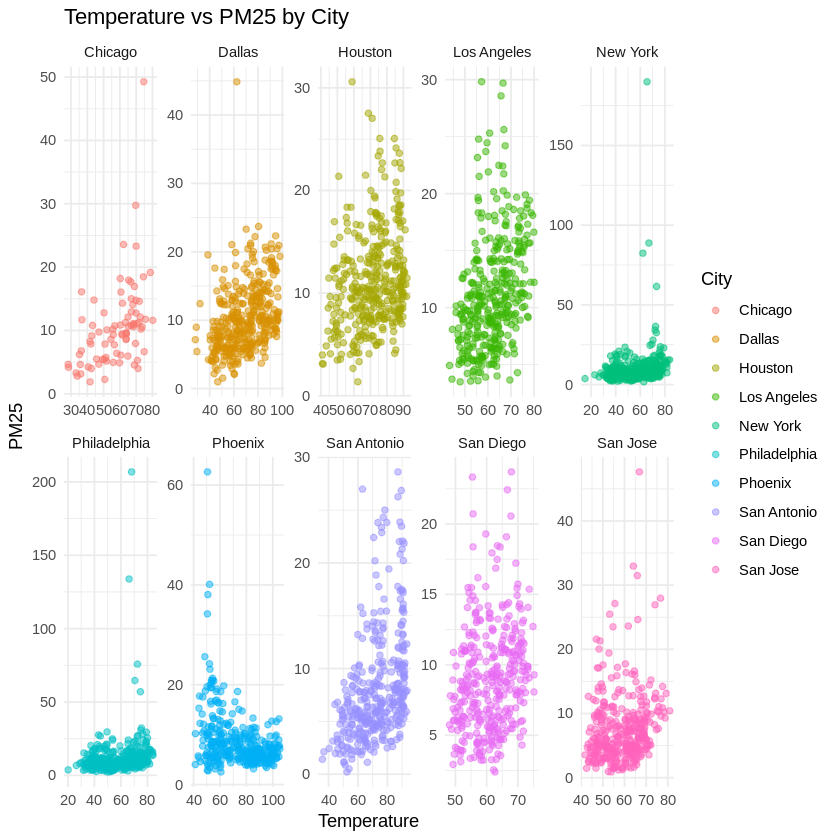

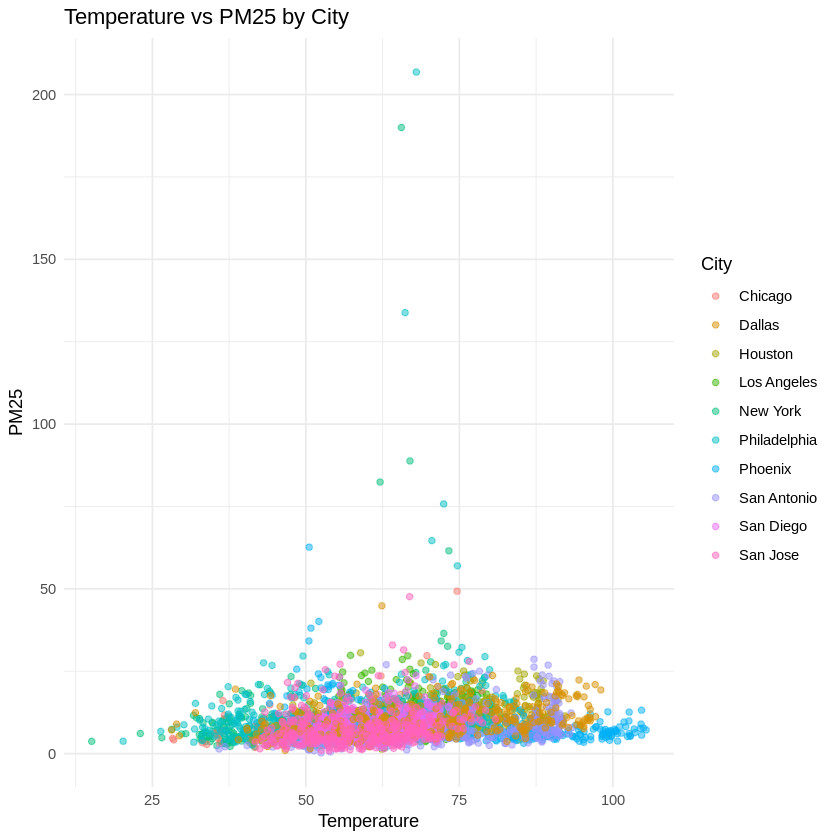

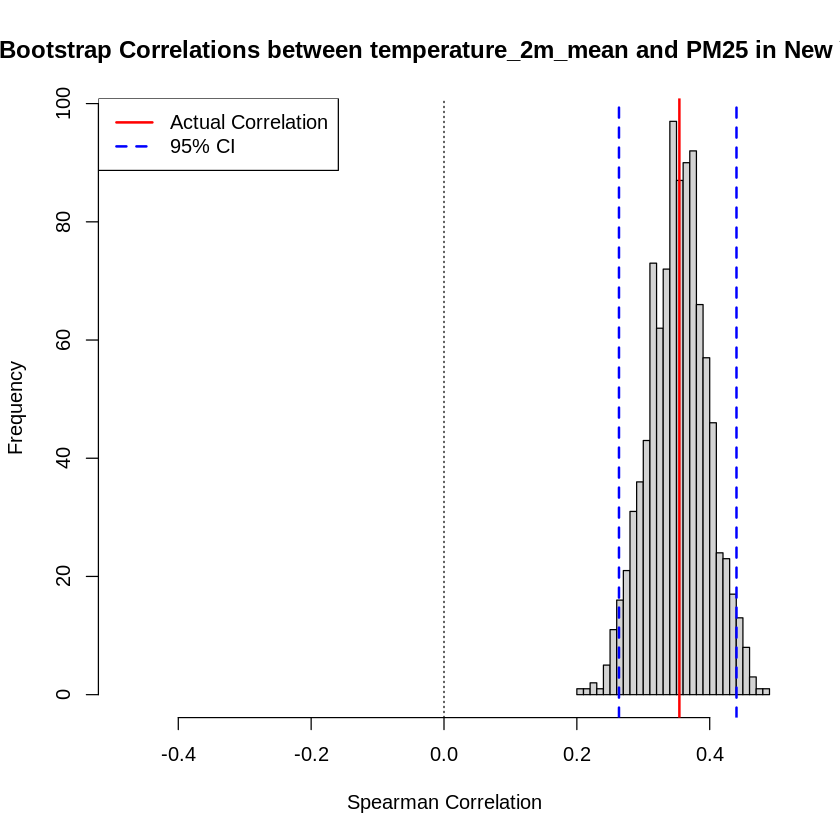

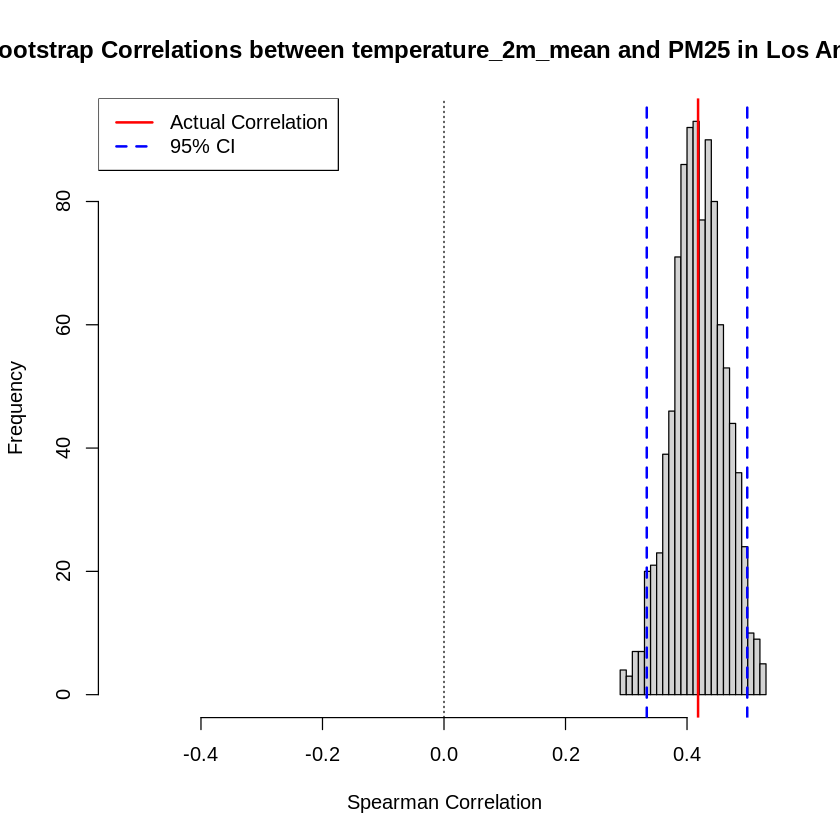

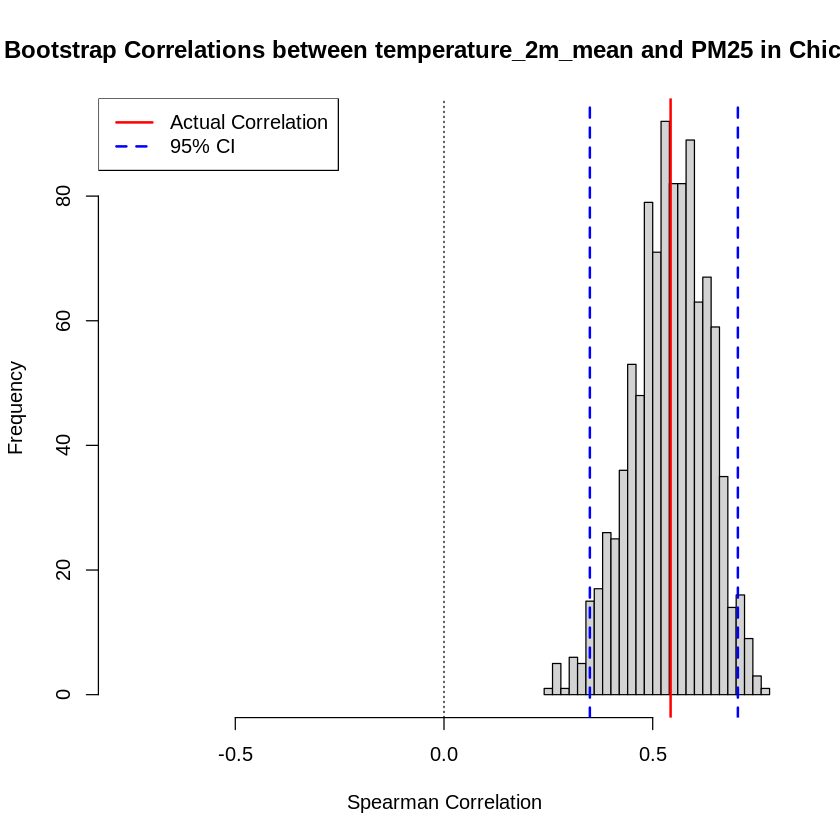

...

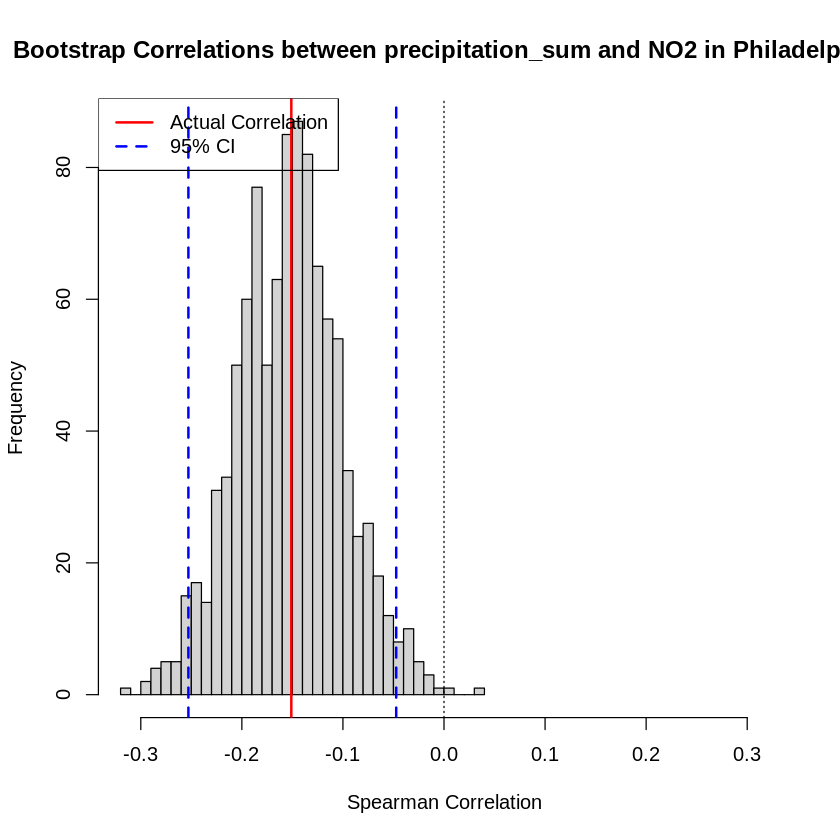

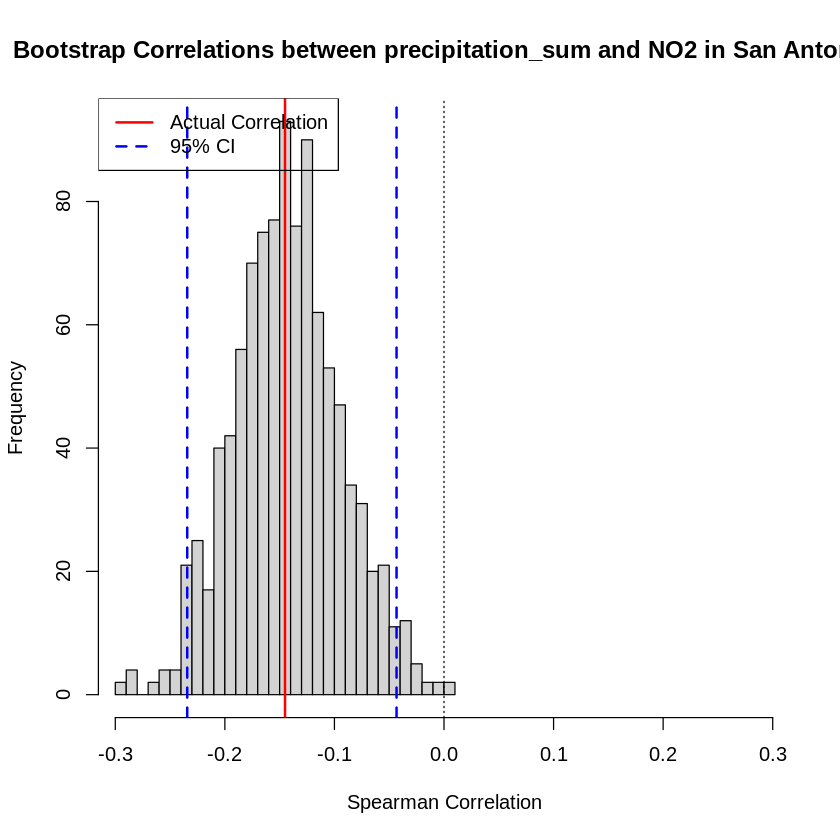

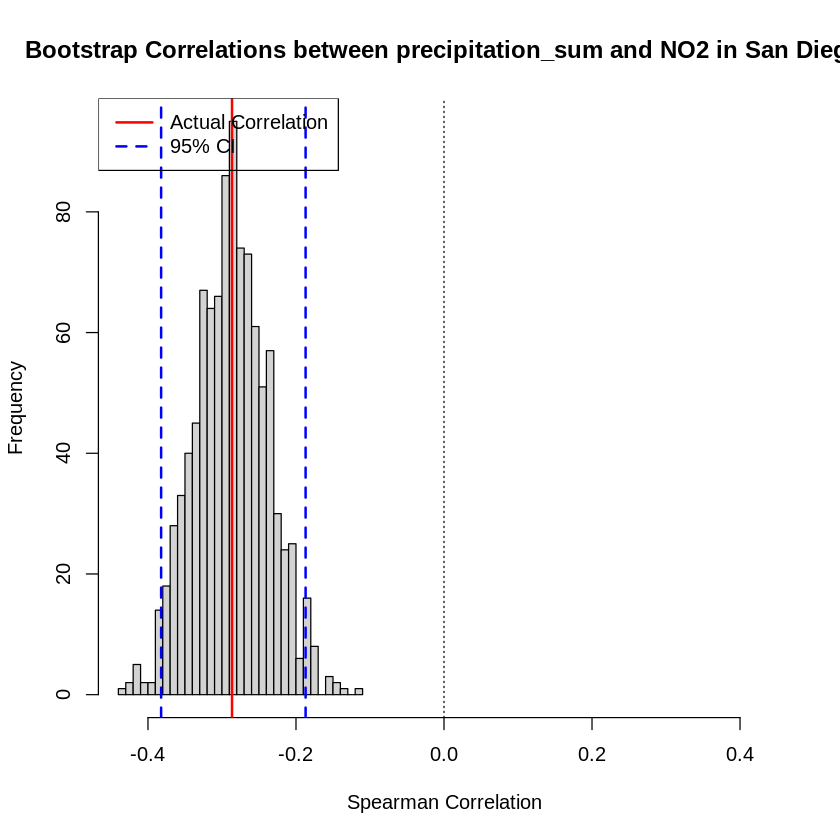

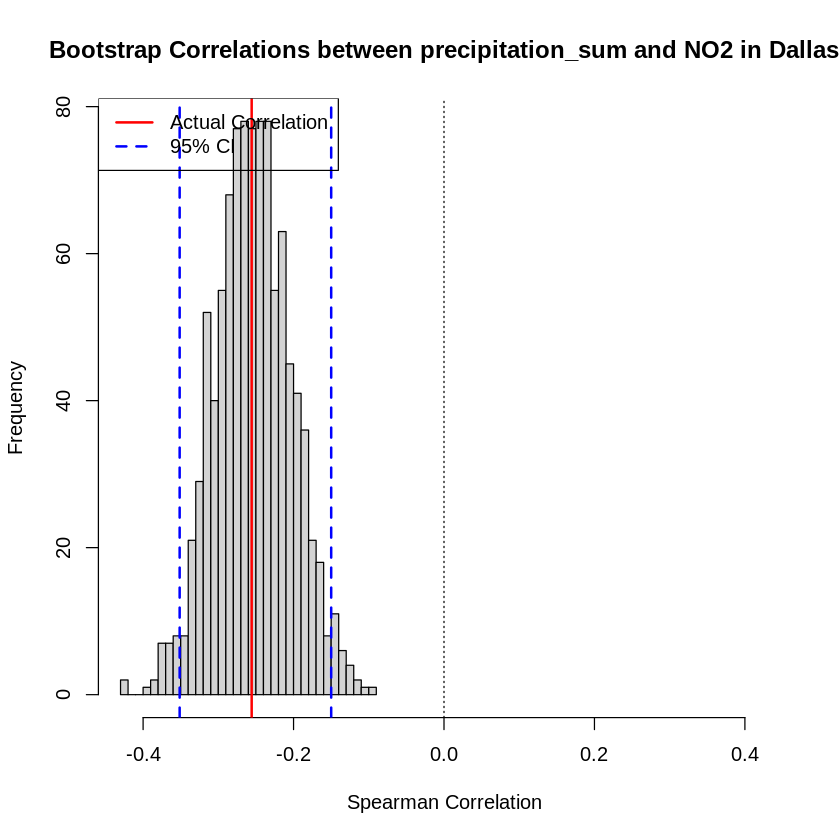

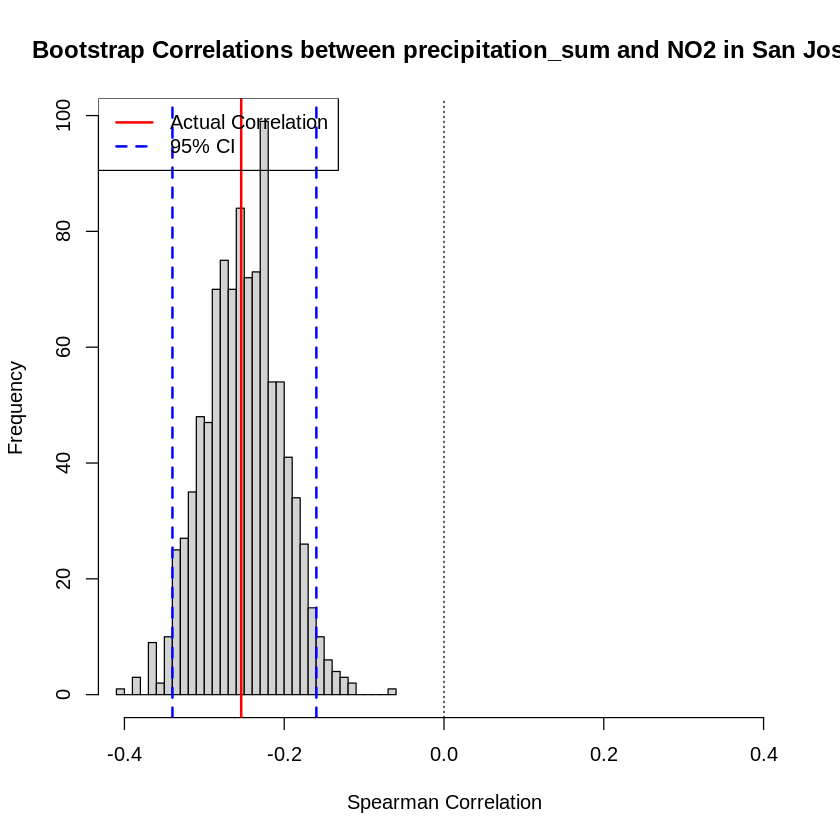

In [ ]:
bootstrap <- function(df, city, feature, pollutant, b){
  bootstrap_correlations <- numeric(b)
  for (i in 1:b){
    sample <- df[sample(nrow(df), replace = TRUE), ]
    bootstrap_correlations[i] <- cor(sample[[feature]], sample[[pollutant]], method = "spearman")
  }

  # actual correlation between pollutant and temperature
  actual_correlation <- cor(df[[feature]], df[[pollutant]], method = "spearman")

  # 95% confidence interval
  ci <- quantile(bootstrap_correlations, c(0.025, 0.975))

  round(actual_correlation, 3)
  round(ci, 3)
  
  # plot histogram of bootstrap correlations and mark actual correlation and confidence intervals
  # png(paste0("../../plots/", city, "_bootstrap_", feature, "_", pollutant, ".png"))
  m <- max(abs(c(bootstrap_correlations, actual_correlation, ci)))
  hist(bootstrap_correlations, main = paste("Bootstrap Correlations between", feature, "and", pollutant, "in", city), xlab = "Spearman Correlation", breaks = 30, xlim = c(-m, m))
  abline(v = actual_correlation, col = "red", lwd = 2)
  abline(v = ci[1], col = "blue", lwd = 2, lty = 2)
  abline(v = ci[2], col = "blue", lwd = 2, lty = 2)
  abline(v = 0, col = "black", lwd = 1, lty = 3)
  legend("topleft", legend = c("Actual Correlation", "95% CI"), col = c("red", "blue"), lwd = 2, lty = c(1,2))
  # dev.off()
}

# empty "../../plots/" directory if it exists
if (dir.exists("../../plots/")) {
  unlink("../../plots/", recursive = TRUE)
}
# create "../../plots/" directory
dir.create("../../plots/")
if (!dir.exists("../../plots/")) {
  dir.create("../../plots/")
}

pollutants <- c("PM25", "O3", "NO2")
features <- c("temperature_2m_mean", "cloud_cover_mean", "relative_humidity_2m_mean", "wind_gusts_10m_mean", "wind_speed_10m_mean", "precipitation_hours", "precipitation_sum")
feature_names <- c("Temperature", "Cloud Cover", "Relative Humidity", "Wind Gusts", "Wind Speed", "Precipitation Hours", "Precipitation Sum")
# features<- c("cloud_cover_mean")
# feature_names <- c("Cloud Cover")

for (pollutant in pollutants) {
    for (i in 1:length(features)) {
        feature <- features[i]
        feature_name <- feature_names[i]
        print(
          ggplot(big_df, aes(x = .data[[feature]], y = .data[[pollutant]], color = City)) +
          geom_point(alpha = 0.5) +
          facet_wrap(~ City, ncol = 5, scales = "free") +
          labs(
            title = paste(feature_name, "vs", pollutant, "by City"),
            x = paste(feature_name),
            y = paste(pollutant)  
          ) +
          theme_minimal()

        )
        print(
        ggplot(big_df, aes(x = .data[[feature]], y = .data[[pollutant]], color = City)) +
          geom_point(alpha = 0.5) +
          labs(
            title = paste(feature_name, "vs", pollutant, "by City"),
            x = paste(feature_name),
            y = paste(pollutant)
          ) +
          theme_minimal()
        )
        for (city in cities) {
            df <- dfs[[city]] 
            png(paste0("../../plots/", city, "_histogram_", feature, ".png"))
            hist(dfs[[city]][[feature]], main = paste("Histogram of", feature_name, "in", city), xlab = feature_name, breaks = 20)
            dev.off()
            png(paste0("../../plots/", city, "_histogram_", pollutant, ".png"))
            hist(dfs[[city]][[pollutant]], main = paste("Histogram of", pollutant, "in", city), xlab = pollutant, breaks = 20) 
            dev.off()
            bootstrap(dfs[[city]], city, feature, pollutant, 1000)

            # print(
            # ggplot(df, aes(x = .data[[feature]], y = .data[[pollutant]])) +
            # geom_point(alpha = 0.5) +
            # labs(
            #     title = paste(feature_name, "vs", pollutant, "in", city),
            #     x = paste(feature_name),
            #     y = paste(pollutant)
            # ) +
            # theme_minimal())
        }
    }
}

In [ ]:
bootstrap <- function(df, city, feature, pollutant, b){
  bootstrap_correlations <- numeric(b)
  for (i in 1:b){
    sample <- df[sample(nrow(df), replace = TRUE), ]
    bootstrap_correlations[i] <- cor(sample[[feature]], sample[[pollutant]], method = "spearman")
  }
  return(bootstrap_correlations)

  # actual correlation between pollutant and temperature
  actual_correlation <- cor(df[[feature]], df[[pollutant]], method = "spearman")

  # 95% confidence interval
  ci <- quantile(bootstrap_correlations, c(0.025, 0.975))

  round(actual_correlation, 3)
  round(ci, 3)
  
  # plot histogram of bootstrap correlations and mark actual correlation and confidence intervals
  # png(paste0("../../plots/", city, "_bootstrap_", feature, "_", pollutant, ".png"))
  # dev.off()
}

pollutants <- c("PM25")
features <- c("temperature_2m_mean")
feature_names <- c("Temperature")
# features<- c("cloud_cover_mean")
# feature_names <- c("Cloud Cover")

for (pollutant in pollutants) {
    for (i in 1:length(features)) {
        feature <- features[i]
        feature_name <- feature_names[i]
        corrs <- c()
        unique <- c()
        for (city in cities) {
            df <- dfs[[city]] 
            if(city == "Phoenix"){
               unique <- c(unique, city)
                next
            }
            corrs <- c(corrs, bootstrap(dfs[[city]], city, feature, pollutant, 1000))

        }
        df_plot <- rbind(data.frame(corr = corrs, group="Other Cities"), data.frame(corr = unique, group="Arizona"))
        # m <- max(abs(c(corrs)))
        # hist(corrs, main = paste("Bootstrap Correlations between", feature, "and", pollutant, "in", city), xlab = "Spearman Correlation", breaks = 30, xlim = c(-m, m))
        ggplot(df_plot, aes(x = corr, fill = group)) +
          geom_histogram(alpha = 0.6, position = "identity", bins = 30) +
          scale_fill_manual(values = c("Other Cities" = "steelblue", "Phoenix" = "orange")) +
          labs(
              title = paste("Bootstrap Correlations for", feature, "and", pollutant),
              x = "Spearman Correlation",
              y = "Count"
          ) +
          theme_minimal()
               
    }
}

ERROR: [1m[33mError[39m in `geom_histogram()`:[22m
[1m[22m[33m![39m Problem while computing stat.
[36mℹ[39m Error occurred in the 1st layer.
[1mCaused by error in `setup_params()`:[22m
[1m[22m[33m![39m `stat_bin()` requires a continuous [32mx[39m aesthetic.
[31m✖[39m the [32mx[39m aesthetic is discrete.
[36mℹ[39m Perhaps you want `stat="count"`?
